In [1]:
from diffusers import DDPMPipeline

ddpm = DDPMPipeline.from_pretrained('google/ddpm-celebahq-256').to('cpu')

diffusion_pytorch_model.safetensors not found


Fetching 4 files:   0%|          | 0/4 [00:00<?, ?it/s]

diffusion_pytorch_model.bin:   9%|9         | 41.9M/455M [00:00<?, ?B/s]

C:\code\ai-images-video-generation\.venv\Lib\site-packages\huggingface_hub\file_download.py:159: UserWarning: `huggingface_hub` cache-system uses symlinks by default to efficiently store duplicated files but your machine does not support them in C:\Users\grigo\.cache\huggingface\hub\models--google--ddpm-celebahq-256. Caching files will still work but in a degraded version that might require more space on your disk. This warning can be disabled by setting the `HF_HUB_DISABLE_SYMLINKS_WARNING` environment variable. For more details, see https://huggingface.co/docs/huggingface_hub/how-to-cache#limitations.
To support symlinks on Windows, you either need to activate Developer Mode or to run Python as an administrator. In order to see activate developer mode, see this article: https://docs.microsoft.com/en-us/windows/apps/get-started/enable-your-device-for-development
  warnings.warn(message)


Loading pipeline components...:   0%|          | 0/2 [00:00<?, ?it/s]

An error occurred while trying to fetch C:\Users\grigo\.cache\huggingface\hub\models--google--ddpm-celebahq-256\snapshots\cd5c944777ea2668051904ead6cc120739b86c4d: Error no file named diffusion_pytorch_model.safetensors found in directory C:\Users\grigo\.cache\huggingface\hub\models--google--ddpm-celebahq-256\snapshots\cd5c944777ea2668051904ead6cc120739b86c4d.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


In [2]:
image = ddpm(num_inference_steps=30).images[0]

  0%|          | 0/30 [00:00<?, ?it/s]

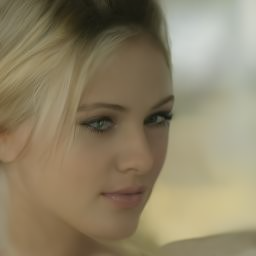

In [3]:
image

  0%|          | 0/10 [00:00<?, ?it/s]

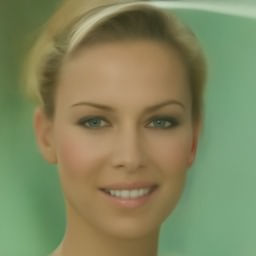

In [4]:
image2 = ddpm(num_inference_steps=10).images[0]
image2

  0%|          | 0/60 [00:00<?, ?it/s]

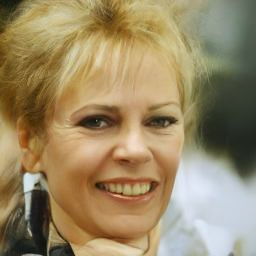

In [5]:
image3 = ddpm(num_inference_steps=60).images[0]
image3

In [6]:
from diffusers import DDPMScheduler, UNet2DModel

scheduler = DDPMScheduler.from_pretrained('google/ddpm-celebahq-256')

In [9]:
model = UNet2DModel.from_pretrained('google/ddpm-celebahq-256')

An error occurred while trying to fetch google/ddpm-celebahq-256: google/ddpm-celebahq-256 does not appear to have a file named diffusion_pytorch_model.safetensors.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


In [10]:
scheduler.set_timesteps(50)

In [11]:
scheduler.timesteps

tensor([980, 960, 940, 920, 900, 880, 860, 840, 820, 800, 780, 760, 740, 720,
        700, 680, 660, 640, 620, 600, 580, 560, 540, 520, 500, 480, 460, 440,
        420, 400, 380, 360, 340, 320, 300, 280, 260, 240, 220, 200, 180, 160,
        140, 120, 100,  80,  60,  40,  20,   0])

In [12]:
import torch

In [13]:
sample_size = model.config.sample_size
sample_size

256

In [14]:
noise = torch.randn((1,3,sample_size,sample_size), device='cpu')

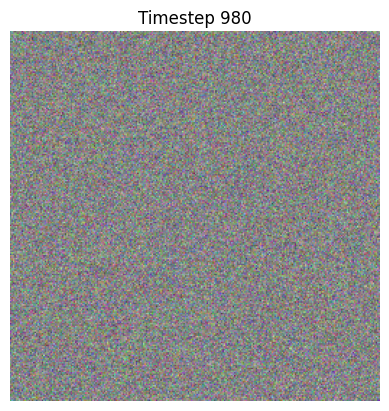

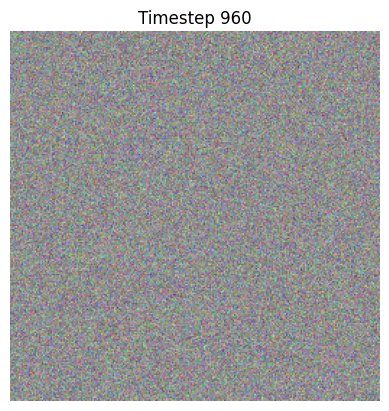

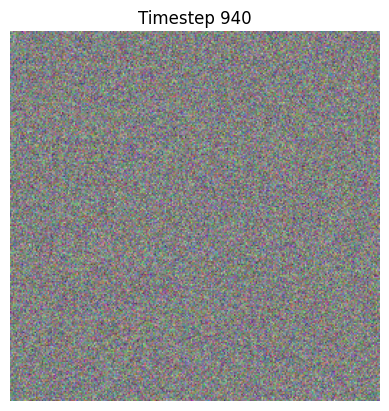

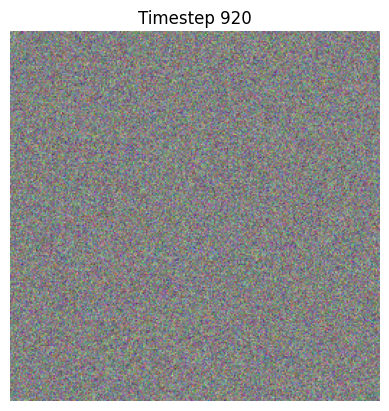

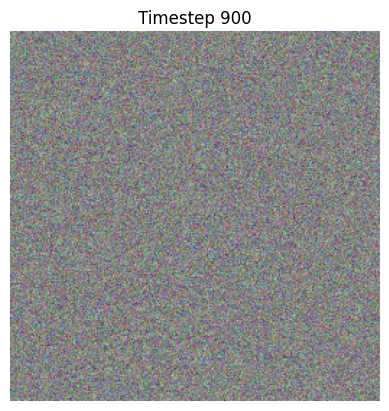

...

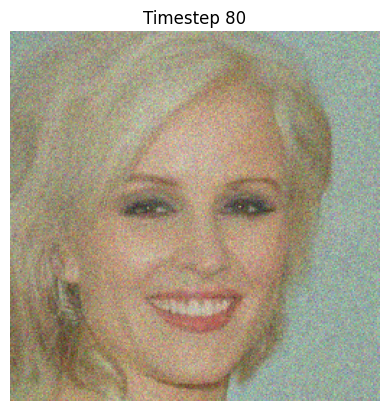

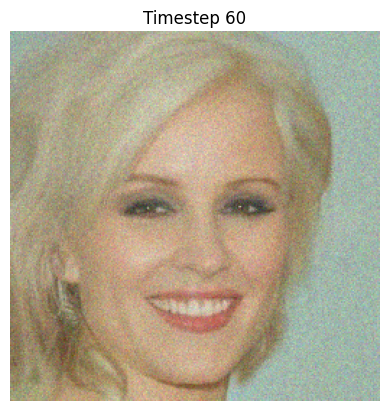

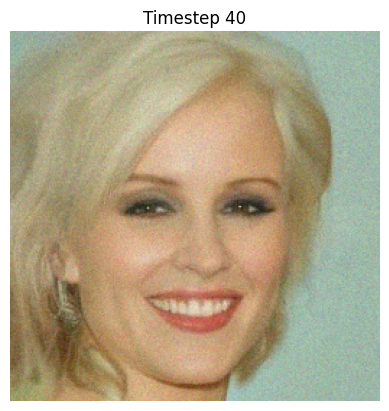

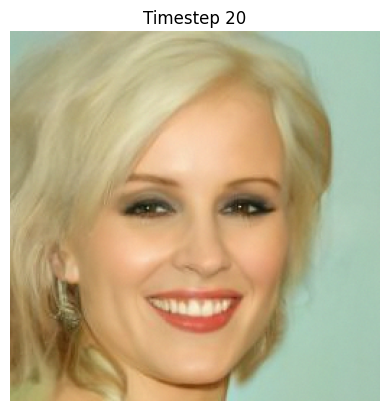

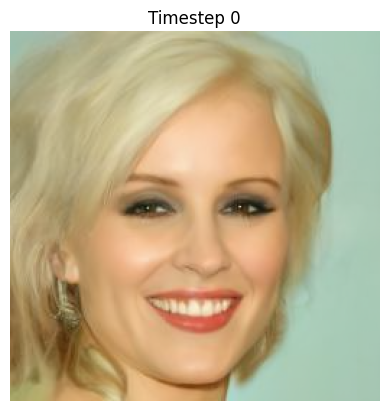

In [18]:
import numpy as np
import matplotlib.pyplot as plt

input = noise
for t in scheduler.timesteps:
    with torch.no_grad():
        noisy_residual = model(input,t).sample
        
    previous_noisy_sample = scheduler.step(noisy_residual, t, input).prev_sample
    
    input = previous_noisy_sample
    
        # Convert tensor to numpy array and handle batch dimension
    image = input.squeeze().cpu().numpy()  # Remove batch dimension; shape (3, H, W)
    
    # Handle RGB image format (3, H, W) -> (H, W, 3)
    if image.shape[0] == 3:
        image = np.transpose(image, (1, 2, 0))  # Transpose to (H, W, 3)
    
    # Normalize the image if necessary
    image = (image - image.min()) / (image.max() - image.min())  # Normalize to [0, 1]
    
    # Display the image
    plt.imshow(image)
    plt.title(f'Timestep {t}')
    plt.axis('off')  # Hide axes
    plt.show()

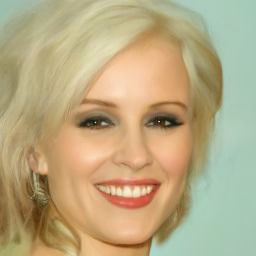

In [20]:
from PIL import Image
import numpy as np

image = (input /2 + 0.5).clamp(0,1).squeeze()
image = (image.permute(1,2,0)*255).round().to(torch.uint8).cpu().numpy()

image = Image.fromarray(image)
image

## AutoPipelines

In [2]:
#https://huggingface.co/docs/diffusers/en/api/pipelines/auto_pipeline - interesting

from diffusers import AutoPipelineForText2Image
pipeline = AutoPipelineForText2Image.from_pretrained('dreamlike-art/dreamlike-photoreal-2.0')

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

C:\code\ai-images-video-generation\.venv\Lib\site-packages\transformers\tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


In [3]:
prompt = 'cinematic photo of a girl in a blue dress travelling in Singapore'

image = pipeline(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

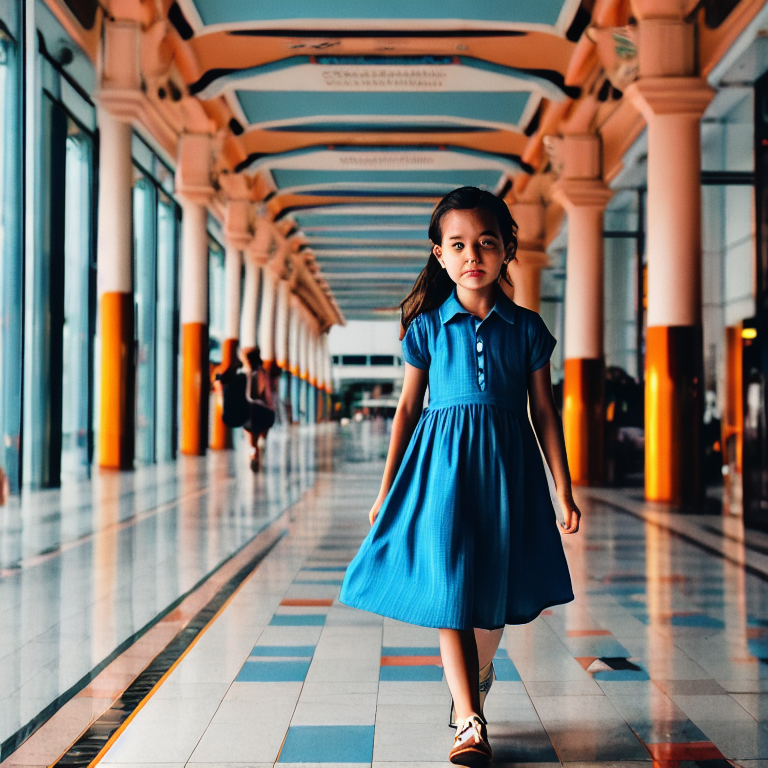

In [4]:
image